
# MTH3302 : Méthodes probabilistes et statistiques pour l'I.A.

Jonathan Jalbert<br/>
Professeur agrégé au Département de mathématiques et de génie industriel<br/>
Polytechnique Montréal<br/>

## Projet effectué par

L'équipe G composé de:
* Guillaume Thibault - 1948612
* Jean-Sébastien Patenaude - 1961302
* Guellati Mohamed Wassim - 1775608
* Jacob Brisson - 1954091
* Takumi Therville - 2164735

### Déclaration d’intégrité relative au plagiat

Nous certifions sur l’honneur :

* Que les résultats décrits dans ce rapport sont l’aboutissement de notre travail.
* Que nous sommes les auteurs de ce rapport.
* Que nous n'avons pas utilisé des sources ou résultats tiers sans clairement les citer et les référencer selon les règles bibliographiques préconisées.
Nous déclarons que ce travail ne peut être soupçonné de plagiat.

# Projet A2021 : Prédire les maladies cardiaques

La description du projet est disponible à l'adresse suivante :
https://www.kaggle.com/t/3a185493d8bb48d8961ad50e465bed4f

Ce calepin Jupyter de base permet de 

1. Charger les données fournies.
2. Effectuer une analyse exploratoire sommaire des données.
3. Développer un modèle simple de prédiction.
4. Générer le fichier de prédictions à téléverser sur Kaggle.

Dans un premier temps, vous devrez récupérer les données sous l'onglet *data* du site Kaggle. Il y a deux fichiers :
- train.csv
- test.csv

Le fichier *train.csv* contient les données sur lesquelles vous pouvez entraîner votre modèle. Il sera ensuite évaluée sur les données de l'ensemble *test.csv* lorsque vous aurez téléversé vos prédictions sur Kaggle. 

### Consignes

- Vous devez constituer une équipe de 3 à 5 personnes.
- Au moins une solution doit être proposée sur Kaggle.
- Utilisez votre numéro d'équipe pour téléverser vos prédictions sur Kaggle.
- Un seul fichier .ipynb par équipe faisant office de rapport et permettant de reproduire vos meilleures prédictions doit être remis.
- Le langage Julia doit être utilisé.
- Votre démarche doit être rigoureusement justifiée (consultez la grille de correction pour vous orienter).

### Quelques conseils

Votre calepin doit permettre de suivre clairement votre raisonnement et de reproduire vos résultats. Garder à l'esprit que vos résultats et votre démarche doivent être reproductibles par une personne à l'extérieur de votre équipe. Le calepin constitue le rapport. Servez vous des cellules de texte pour décrire ce que vous faites.

Je vous encourage fortement à faire une analyse exploratoire de vous données pour développer une meilleure expertise du problème. C'est une étape qui est toujours négligée par les débutants mais qui est essentielle. C'est avec l'analyse exploratoire que vous viendra des idées d'amélioration, par exemple créer de nouvelles variables explicatives.

Vous pouvez utiliser directement tout ce qui se retrouve dans les notes de cours sans explication et toutes les librairies utilisées dans le cours (incluant mes fonctions).

Ce calepin de base contient un modèle très simple de prédiction : on prédit 0 débordement à tous les jours. Ce sera votre travail d'améliorer ces prédictions naïves avec la méthode de votre choix.

Il faudra que vous trouviez un moyen de traiter les données manquantes. La plupart du temps, une méthode simple d'imputation (de remplacement) des données manquantes est appropriée.

Prenez la peine de tout documenter, même les essais infructueux. Ce n'est pas nécessaire de les expliquer en détails, mais c'est important de les mentionner au moins succintement dans la discussion avec une raison possible pour leur échec. De cette façon, une personne qui reprendra votre travail dans le futur ne perdra pas de temps à réessayer une méthode déjà implémentée et infructueuse.

Vous pouvez aussi indiquer dans votre rapport les raisons qui vous font croire pourquoi une méthode à moins bien performée que ce à quoi vous vous attendiez. Vous pouvez également mentionner ce que vous auriez pu tenter si vous aviez eu plus de temps ou plus de données, etc. L'idée est de guider le prochain scientifique qui prendra la relève de votre travail.

Vous êtes limités à deux soumissions par jour par équipe sur Kaggle. Je vous suggère donc de bien tester vos modèles localement et de ne téléverser que vos meilleurs candidats.

In [ ]:
ENV["COLUMNS"] = 150 # Permet de voir plus de colonnes des dataframes
using Pkg
Pkg.add("CSV")
Pkg.add("DataFrames")
Pkg.add("Gadfly")
Pkg.add("GLM")
Pkg.add("Statistics")
Pkg.add("StatsBase")
Pkg.add("Random")
Pkg.add("DecisionTree")

    Updating registry at `~/.julia/registries/General`
   Resolving package versions...
   Installed CodecZlib ────────── v0.7.0
   Installed InlineStrings ────── v1.1.0
   Installed SentinelArrays ───── v1.3.8
   Installed WeakRefStrings ───── v1.4.1
   Installed PooledArrays ─────── v1.4.0
   Installed FilePathsBase ────── v0.9.17
   Installed TranscodingStreams ─ v0.9.6
   Installed CSV ──────────────── v0.9.11
    Updating `~/.julia/environments/v1.6/Project.toml`
  [336ed68f] + CSV v0.9.11
    Updating `~/.julia/environments/v1.6/Manifest.toml`
  [336ed68f] + CSV v0.9.11
  [944b1d66] + CodecZlib v0.7.0
  [48062228] + FilePathsBase v0.9.17
  [842dd82b] + InlineStrings v1.1.0
  [2dfb63ee] + PooledArrays v1.4.0
  [91c51154] + SentinelArrays v1.3.8
  [3bb67fe8] + TranscodingStreams v0.9.6
  [ea10d353] + WeakRefStrings v1.4.1
  [9fa8497b] + Future
Precompiling project...
  ✓ InlineStrings
  ✓ TranscodingStreams
  ✓ SentinelArrays
  ✓ PooledArrays
  ✓ CodecZlib
  ✓ FilePathsBase
  ✓ Wea

In [193]:
using CSV, DataFrames, Gadfly, GLM, Statistics, StatsBase, Random, DecisionTree

## Fonctions utiles pour le traitement des données. La majorité de ces fonctions ont été implémentées pour certains tests mais ne sont pas utilisées pour la version finale du modèle.

In [194]:
"""
Functions utils pour la transformation des données
"""

function check_missing(df::DataFrame)
    """
    Print le nombre de valeurs manquantes par colonne
    @params:
        - df: DataFrame à analyser
    """
    for i in 1:size(df,2)
        nb_missing = count(ismissing.(df[:, i]))
        var_name = names(df)[i]
        
        println("$var_name: $nb_missing")
    end
end


function replace_missing_by_mean(df::DataFrame)
    """
    Function remplacant les valeurs manquantes par la moyenne
    @params:
        - df: DataFrame à analyser
    @return
        - DataFrame avec les valeurs remplacer
    """
    df_copy = copy(df)
    m = trunc(Int, mean(skipmissing(df_copy.Cholesterol)))

    for i=1:length(df_copy.Cholesterol)
        if(ismissing(df_copy.Cholesterol[i]))
           df_copy.Cholesterol[i]=m 
        end
    end
    return df_copy
end

function replace_missing_by_median(df::DataFrame)
    """
    Function remplacant les valeurs manquantes par la mediane
    @params:
        - df: DataFrame à analyser
    @return
        - DataFrame avec les valeurs remplacer
    """
    df_copy = copy(df)
    m = trunc(Int, median(skipmissing(df_copy.Cholesterol)))

    for i=1:length(df_copy.Cholesterol)
        if(ismissing(df_copy.Cholesterol[i]))
           df_copy.Cholesterol[i]=m 
        end
    end
    return df_copy
end

function convert_age_3_class(df, boundary=(25, 55))
    """
    Function convertissant la colonne Age du dataframe df en 3 classes
    @params:
        - df: DataFrame à modifier
        - boundary: Set avec les limites d'age des deux classes
    """
    boundary = [25, 55]
    
    for i=1:length(df.Age)
        if df.Age[i] < boundary[1]
            df.Age[i] = 0
        elseif boundary[1] <= df.Age[i] <= boundary[2]
            df.Age[i] = 1
        else
            df.Age[i] = 2  
        end
    end
    #  Pour que GLM considère la classe comme une variable categorique    
    df[!, :Age] = string.(df[:, :Age])  
end

function second_convert_restingBP_6_class(df, boundary=(100, 110, 120, 130 , 140))
    """
    Function convertissant la colonne RestingBP du dataframe df en 6 classes
    @params:
        - df: DataFrame à modifier
        - boundary: Set avec les plages de restingBP
    """
    vec = Vector{String}(undef, length(df.RestingBP))
    boundary1 = boundary[1]
    boundary2 = boundary[2]
    boundary3 = boundary[3]
    boundary4 = boundary[4]
    boundary5 = boundary[5]
    for i=1:length(df.RestingBP)
        if df.RestingBP[i] < boundary[1]
            vec[i] = " $boundary1 <"
        elseif boundary[1] <= df.RestingBP[i] <= boundary[2]
            vec[i] = "$boundary1 < x < $boundary2"
        elseif boundary[2] <= df.RestingBP[i] <= boundary[3]
            vec[i] = "$boundary2 < x < $boundary3"
        elseif boundary[3] <= df.RestingBP[i] <= boundary[4]
            vec[i] = "$boundary3 < x < $boundary4"
        elseif boundary[4] <= df.RestingBP[i] <= boundary[5]
            vec[i] = "$boundary4 < x < $boundary5"
        else
            vec[i] = "> $boundary5"
        end
    end
    #  Pour que GLM considère la classe comme une variable categorique    
    df[!, :RestingBP] = string.(vec)  
end

function convert_restingBP_13_class(df, boundary=(100 , 110, 120, 130, 140 , 150 , 160,170,180,190,200))
    """
    Function convertissant la colonne RestingBP du dataframe df en 13 classes
    @params:
        - df: DataFrame à modifier
        - boundary: Set avec les plages de restingBP
    """
    vec = Vector{String}(undef, length(df.RestingBP))
    boundary1 = boundary[1]
    boundary2 = boundary[2]
    boundary3 = boundary[3]
    boundary4 = boundary[4]
    boundary5 = boundary[5]
    boundary6 = boundary[6]
    boundary7 = boundary[7]
    boundary8 = boundary[8]
    boundary9 = boundary[9]
    boundary10 = boundary[10]
    boundary11 = boundary[11]
    for i=1:length(df.RestingBP)
        if df.RestingBP[i] < boundary[1]
            vec[i] = " $boundary1 <"
        elseif boundary[1] <= df.RestingBP[i] <= boundary[2]
            vec[i] = "$boundary1 < x < $boundary2"
        elseif boundary[2] <= df.RestingBP[i] <= boundary[3]
            vec[i] = "$boundary2 < x < $boundary3"
        elseif boundary[3] <= df.RestingBP[i] <= boundary[4]
            vec[i] = "$boundary3 < x < $boundary4"
        elseif boundary[4] <= df.RestingBP[i] <= boundary[5]
            vec[i] = "$boundary4 < x < $boundary5"
        elseif boundary[5] <= df.RestingBP[i] <= boundary[6]
            vec[i] = "$boundary5 < x < $boundary6"
        elseif boundary[6] <= df.RestingBP[i] <= boundary[7]
            vec[i] = "$boundary6 < x < $boundary7"
        elseif boundary[7] <= df.RestingBP[i] <= boundary[8]
            vec[i] = "$boundary7 < x < $boundary8"
        elseif boundary[8] <= df.RestingBP[i] <= boundary[9]
            vec[i] = "$boundary8 < x < $boundary9"
        elseif boundary[9] <= df.RestingBP[i] <= boundary[10]
            vec[i] = "$boundary9 < x < $boundary10"
        elseif boundary[10] <= df.RestingBP[i] <= boundary[11]
            vec[i] = "$boundary10 < x < $boundary11"
        else
            vec[i] = "> $boundary11"
        end
    end
    #  Pour que GLM considère la classe comme une variable categorique    
    df[!, :RestingBP] = string.(vec)  
end

function convert_cholesterol_9_class(df, boundary=(175 , 200, 225, 250, 275 , 300 , 325))
    """
    Function convertissant la colonne Cholesterol du dataframe df en 9 classes
    @params:
        - df: DataFrame à modifier
        - boundary: Set avec les limites de cholesterol des deux classes
    """
    vec = Vector{String}(undef, length(df.Cholesterol))
    boundary1 = boundary[1]
    boundary2 = boundary[2]
    boundary3 = boundary[3]
    boundary4 = boundary[4]
    boundary5 = boundary[5]
    boundary6 = boundary[6]
    boundary7 = boundary[7]
    for i=1:length(df.Cholesterol)
        if df.Cholesterol[i] < boundary[1]
            vec[i] = " $boundary1 <"
        elseif boundary[1] <= df.Cholesterol[i] <= boundary[2]
            vec[i] = "$boundary1 < x < $boundary2"
        elseif boundary[2] <= df.Cholesterol[i] <= boundary[3]
            vec[i] = "$boundary2 < x < $boundary3"
        elseif boundary[3] <= df.Cholesterol[i] <= boundary[4]
            vec[i] = "$boundary3 < x < $boundary4"
        elseif boundary[4] <= df.Cholesterol[i] <= boundary[5]
            vec[i] = "$boundary4 < x < $boundary5"
        elseif boundary[5] <= df.Cholesterol[i] <= boundary[6]
            vec[i] = "$boundary5 < x < $boundary6"
        elseif boundary[6] <= df.Cholesterol[i] <= boundary[7]
            vec[i] = "$boundary6 < x < $boundary7"
        else
            vec[i] = "> $boundary7"
        end
    end
    #  Pour que GLM considère la classe comme une variable categorique    
    df[!, :Cholesterol] = string.(vec)  
end

function convert_oldpeak_2_class(df, boundary=0.8)
    """
    Function convertissant la colonne Oldpeak du dataframe df en 2 classes
    @params:
        - df: DataFrame à modifier
    """
    for i=1:length(df.Oldpeak)
        if df.Oldpeak[i] <= boundary
            df.Oldpeak[i] = Int(1)
        else
            df.Oldpeak[i] = Int(2)
        end
    end
    #  Pour que GLM considère la classe comme une variable categorique    
    df[!, :Oldpeak] = string.(df[:, :Oldpeak])
end

function convert_STSlope(df)
    """
    Function convertissant la colonne STSlope du dataframe df en 2 classes
        selon l'analyse une analyse fait au préalable (voir plus bas)
    @params:
        - df: DataFrame à modifier
    """
    for i=1:length(df.STSlope)
        if df.STSlope[i] == "Down" || df.STSlope[i] == "Flat"
            df.STSlope[i] = "F_D"
        end
    end
end  

function convert_MaxHR(df, boundary=130)
    """
    Function convertissant la colonne MaxHr en deux classes
    @params:
        - df: DataFrame à modifier
        - boundary: Int avec la limite du maxHax séparant les deux class
    """
    for i=1:length(df.MaxHR)
        if df.MaxHR[i] <= boundary
             df.MaxHR[i] = Int(1)
        else
            df.MaxHR[i] = Int(2)
        end
    end
    #  Pour que GLM considère la classe comme une variable categorique
    df[!, :MaxHR] = string.(df[:, :MaxHR])
end 

function standardise_df(df)
    """
    Fonction de standardisation à modifier pour s'assurer de faire la même 
        transformation avec l'ensemble d'entrainement et test 
    """
    convert_STSlope(df)
    convert_age_3_class(df)
    convert_oldpeak_2_class(df)
    convert_MaxHR(df)
end

standardise_df (generic function with 1 method)

In [195]:
function df_to_float(data, weight)
    data_m = replace_missing_by_mean(data);

    df = DataFrame();

    # Age
    Age = [];
    for i=1:length(data_m.Age)
        age = data_m.Age[i];
        if age > 100
            age = 100;
        end
        age = Float64(age/100);
        append!(Age, age * weight[1]);
    end 
    df.Age = Age;

    # Sex
    Atts = []
    for i=1:length(data_m.Sex)
        if data_m.Sex[i] == "M"
            append!(Atts, 0);
        else
            append!(Atts, 1 * weight[2]);
        end
    end
    df.Sex = Atts;


    # ChestPainType 
    Atts = []
    for i=1:length(data_m.ChestPainType)
        if data_m.ChestPainType[i] == "ASY"
            append!(Atts, 0);
        elseif data_m.ChestPainType[i] == "NAP"
            append!(Atts, 0.333 * weight[3]);
        elseif data_m.ChestPainType[i] == "ATA"
            append!(Atts, 0.666 * weight[3]);
        else
            append!(Atts, 1 * weight[3]);
        end
    end
    df.ChestPainType = Atts;

    # RestingBP
    Atts = []
    for i=1:length(data_m.RestingBP)
        append!(Atts, (data_m.RestingBP[i] / 200) * weight[4]); # 200 is the max value of ours data
    end
    df.RestingBP = Atts;

    # Cholesterol
    Atts = []
    for i=1:length(data_m.Cholesterol)
        append!(Atts, (data_m.Cholesterol[i] / 600) * weight[5]); # Max: 603
    end
    df.Cholesterol = Atts;

    # FastingBS
    Atts = []
    for i=1:length(data_m.FastingBS)
        append!(Atts, data_m.FastingBS[i] * weight[6]); 
    end
    df.FastingBS = Atts;

    # RestingECG
    Atts = []
    for i=1:length(data_m.RestingECG)
        if data_m.RestingECG[i] == "Normal"
            append!(Atts, 0);
        elseif data_m.RestingECG[i] == "LVH"
            append!(Atts, 0.5 * weight[7]);
        else
            append!(Atts, 1 * weight[7]);
        end
    end
    df.RestingECG = Atts;


    # MaxHR
    Atts = []
    for i=1:length(data_m.MaxHR)
        append!(Atts, (data_m.MaxHR[i]/200)* weight[8]); # Max: 195
    end
    # print(maximum(Atts))
    df.MaxHR = Atts;


    # ExerciseAngina
    Atts = []
    for i=1:length(data_m.ExerciseAngina)
        if data_m.ExerciseAngina[i] == "Y"
            append!(Atts, 0);
        else
            append!(Atts, 1 * weight[9]);
        end
    end
    df.ExerciseAngina = Atts;

    # Oldpeak
    Atts = []
    for i=1:length(data_m.Oldpeak)
        append!(Atts, (data_m.Oldpeak[i]/6.2) * weight[10]); # Max: 6.2
    end
    # print(maximum(Atts))
    df.Oldpeak = Atts;

    # STSlope
    Atts = []
    for i=1:length(data_m.STSlope)
        if data_m.STSlope[i] == "Flat"
            append!(Atts, 1 * weight[11]);
        elseif data_m.STSlope[i] == "Up"
            append!(Atts, 0.8 * weight[11]);
        else
            append!(Atts, 0);
        end
    end
    df.STSlope = Atts;

    # HeartDisease
    Atts = []
    for i=1:length(data_m.HeartDisease)
        append!(Atts, data_m.HeartDisease[i]); 
    end
    # print(maximum(Atts))
    df.HeartDisease = Atts;
    
    return df
end

df_to_float (generic function with 1 method)

## 1. Chargement des données

On charge ici les données d'entrainement pour le modèle.

In [196]:
data = CSV.read("train.csv", DataFrame);

## 2. Analyse exploratoire de l'ensemble de données



In [197]:
first(data,5)

,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String1,String3,Int64,Int64?,Int64,String7,Int64,String1,Float64,String7,Int64
1,1,69,M,ASY,140,110,1,Normal,109,Y,1.5,Flat,1
2,2,60,M,ASY,140,293,0,LVH,170,N,1.2,Flat,1
3,3,52,M,ASY,165,missing,1,Normal,122,Y,1.0,Up,1
4,4,46,M,NAP,120,230,0,Normal,150,N,0.0,Up,0
5,5,61,M,NAP,120,missing,0,Normal,80,Y,0.0,Flat,1


En regardant les premières colonnes de notre jeu de données. On s'aperçoit que nous avons plusieurs données de type catégorique et plusieurs données contine. De plus on s'aperçoit que certaines valeurs sont manquantes en ce qui concerne le cholesterol. 

In [198]:
df_size = size(data, 1);
println("\nTotal of training data: $df_size")

proba_heart_disease = sum(data.HeartDisease)/df_size;
println("\nProbabilité de maladie du coeur dans notre ensemble: $proba_heart_disease")  

println("\nTotal missing data by column: ")
check_missing(data)


Total of training data: 688

Probabilité de maladie du coeur dans notre ensemble: 0.5421511627906976

Total missing data by column: 
ID: 0
Age: 0
Sex: 0
ChestPainType: 0
RestingBP: 0
Cholesterol: 123
FastingBS: 0
RestingECG: 0
MaxHR: 0
ExerciseAngina: 0
Oldpeak: 0
STSlope: 0
HeartDisease: 0


Nous avons un ensemble de données ayant 688 individus. De plus, 54.22%  des personnes de l'ensemble de données on une maladie du coeur.

Parmi ces données, seulement les informations sur le cholestérol de 123 personnes sont manquantes. Afin de pouvoir utiliser ces données et réaliser une analyse des différentes composantes, nous allons remplacer les données manquantes par la moyenne des données existantes. Nous aurions aussi pu remplacer par le mode ou la médianne des données, mais nous avons choisi la moyenne, puisque cela s'applique bien aux données continues et que c'est un choix conventionnel.

In [199]:
# Replace by mean 
data_m = replace_missing_by_mean(data);
data_m

,ID,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,STSlope,HeartDisease
,Int64,Int64,String1,String3,Int64,Int64?,Int64,String7,Int64,String1,Float64,String7,Int64
1,1,69,M,ASY,140,110,1,Normal,109,Y,1.5,Flat,1
2,2,60,M,ASY,140,293,0,LVH,170,N,1.2,Flat,1
3,3,52,M,ASY,165,244,1,Normal,122,Y,1.0,Up,1
4,4,46,M,NAP,120,230,0,Normal,150,N,0.0,Up,0
5,5,61,M,NAP,120,244,0,Normal,80,Y,0.0,Flat,1
6,6,46,M,NAP,150,231,0,Normal,147,N,3.6,Flat,1
7,7,45,F,ATA,112,160,0,Normal,138,N,0.0,Flat,0
8,8,47,M,ASY,140,276,1,Normal,125,Y,0.0,Up,0
9,9,43,M,ASY,150,247,0,Normal,130,Y,2.0,Flat,1


#### 2.1 Représentations de la prédiction de maladie cardiaque en fonction des attributs

Afin de déterminer quels attributs sont importants pour notre analyse, il est nécessaire d'étudier plus en profondeur l'impact des attributs sur la prédiction de maladie cardiaque. Nous allons d'abord commencer par une simple analyse des prédictions de maladie cardiaque en fonction de chaque attribut.

In [200]:
heart_vs_id = plot(data_m, x=:ID, y=:HeartDisease, Geom.point)
heart_vs_age = plot(data_m, x=:Age, y=:HeartDisease, Geom.point)
heart_vs_sex = plot(data_m, x=:Sex, y=:HeartDisease, Geom.point)
heart_vs_chest_pain = plot(data_m, x=:ChestPainType, y=:HeartDisease, Geom.point)
heart_vs_resting_bp = plot(data_m, x=:RestingBP, y=:HeartDisease, Geom.point)
heart_vs_cholesterol = plot(data_m, x=:Cholesterol, y=:HeartDisease, Geom.point)
heart_vs_fasting = plot(data_m, x=:FastingBS, y=:HeartDisease, Geom.point)
heart_vs_resting = plot(data_m, x=:RestingECG, y=:HeartDisease, Geom.point)
heart_vs_max_hr = plot(data_m, x=:MaxHR, y=:HeartDisease, Geom.point)
heart_vs_exercise = plot(data_m, x=:ExerciseAngina, y=:HeartDisease, Geom.point)
heart_vs_oldpeak = plot(data_m, x=:Oldpeak, y=:HeartDisease, Geom.point)
heart_vs_stsslope = plot(data_m, x=:STSlope, y=:HeartDisease, Geom.point)

Gadfly.set_default_plot_size(10cm, 40cm)
vstack(heart_vs_id,heart_vs_age,heart_vs_sex,heart_vs_chest_pain,heart_vs_resting_bp,heart_vs_cholesterol,heart_vs_fasting,heart_vs_resting,heart_vs_max_hr,heart_vs_exercise,heart_vs_oldpeak,heart_vs_stsslope)

Il est difficile de déterminer quels attributs sont les plus importants pour la prédiction des maladies cardiaques avec ces graphiques qui manquent d'informations, surtout pour les variables catégoriques. Il faudra donc effectuer une recherche plus approfondie en prenant un attribut à la fois et en modélisant d'autres manières la relation entre l'attribut et la prédiction. 

#### 2.2 Maladie cardiaque en fonction de l'ID
Pour avoir un aperçu plus représentatif de l'impact d'un attribut sur la prédiction, nous pouvons modéliser les distributions des valeurs de l'attribut en fonction de la classe de la prédiction à l'aide d'un diagramme de boîte à moustaches.

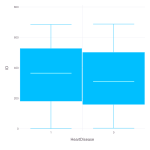

In [201]:
df = select(data_m, :ID, :HeartDisease)

df.HeartDisease = string.(df.HeartDisease)
Gadfly.set_default_plot_size(15cm, 15cm)

plot(df, x=:HeartDisease, y=:ID, Geom.boxplot)

L'id est unique à chaque exemple, il n'est donc pas utile pour permettre d'effectuer des prédictions généralisées. On pourra donc se débarasser de cet attribut. Le diagramme confirme cela, puisque les deux distributions selon la classe de prédiction sont très similaires.

#### 2.3 Maladie cardiaque en fonction de l'age
Pour les attributs qui semblent plus importants que l'ID, on peut alors effectuer une analyse plus poussée en effectuant le diagramme de boîte à moustaches ainsi que le diagramme de densité de l'age en fonction de la classe de prédiction. Nous avons aussi ajouté un diagramme à bandes du taux moyen de maladie cardiaque en fonction de l'age et un diagramme à bandes du nombre de personnes ayant un certain age.

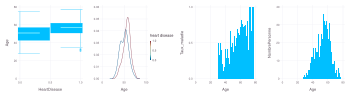

In [202]:
df = select(data_m, :Age, :HeartDisease)

box_age = plot(df, x=:HeartDisease, y=:Age, Geom.boxplot)
density_age = plot(df, x=:Age, color=:HeartDisease, Geom.density, Guide.xlabel(string(:Age)), Guide.colorkey(title="heart disease"))
bar_age = plot(combine(groupby(df, :Age), :HeartDisease => mean => :Taux_maladie), x=:Age, y=:Taux_maladie, Geom.bar)
bar_age_distribution = plot(combine(groupby(df, :Age), nrow => :NombrePersonne), x=:Age, y=:NombrePersonne, Geom.bar)
Gadfly.set_default_plot_size(35cm, 10cm)
hstack(box_age, density_age, bar_age, bar_age_distribution)

On peut remarquer que l'age peut être une variable explicative importante pour la classification, étant donné que la probabilité moyenne de maladie cardiaque augmente avec l'age et que les deux distributions sont différentes selon la classe de prédiction.

#### 2.4 Maladie cardiaque en fonction du Sexe
Nous allons répéter les mêmes diagrammes qu'expliqué à la section précédente pour tous les prochains attributs.

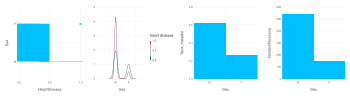

In [203]:
df = select(data_m, :Sex, :HeartDisease)

box_sex = plot(df, x=:HeartDisease, y=:Sex, Geom.boxplot)
density_sex = plot(df, x=:Sex, color=:HeartDisease, Geom.density, Guide.xlabel(string(:Sex)), Guide.colorkey(title="heart disease"))
bar_sex = plot(combine(groupby(df, :Sex), :HeartDisease => mean => :Taux_maladie), x=:Sex, y=:Taux_maladie, Geom.bar)
bar_sex_distribution = plot(combine(groupby(df, :Sex), nrow => :NombrePersonne), x=:Sex, y=:NombrePersonne, Geom.bar)
Gadfly.set_default_plot_size(35cm, 10cm)
hstack(box_sex, density_sex, bar_sex, bar_sex_distribution)

Ici, sachant que le sexe est un attribut catégorique, il est normal que certains diagrammes n'apportent pas beaucoup d'informations. Or, en observant le diagramme à bandes du taux moyen de maladie cardiaque, on peut alors aussi voir que la variable du sexe semble posséder un pouvoir significatif sur les prédictions, puisque la probabilité moyenne de maladie cardiaque semble être plus faible pour les femmes.

#### 2.5 Maladie cardiaque en fonction du type de douleur à la poitrine

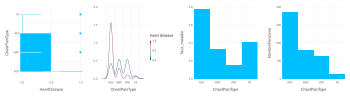

In [204]:
df = select(data_m, :ChestPainType, :HeartDisease)

box_cpt = plot(df, x=:HeartDisease, y=:ChestPainType, Geom.boxplot)
density_cpt = plot(df, x=:ChestPainType, color=:HeartDisease, Geom.density, Guide.xlabel(string(:ChestPainType)), Guide.colorkey(title="heart disease"))
bar_cpt_mean = plot(combine(groupby(df, :ChestPainType), :HeartDisease => mean => :Taux_maladie), x=:ChestPainType, y=:Taux_maladie, Geom.bar)
bar_cpt_distribution = plot(combine(groupby(df, :ChestPainType), nrow => :NombrePersonne), x=:ChestPainType, y=:NombrePersonne, Geom.bar)
Gadfly.set_default_plot_size(35cm, 10cm)
hstack(box_cpt, density_cpt, bar_cpt_mean, bar_cpt_distribution)

À nouveau, cette variable semble présenter un pouvoir de prédiction significatif, il serait donc nécessaire de la considérer.

#### 2.6 Maladie cardiaque en fonction de la tension artérielle au repos

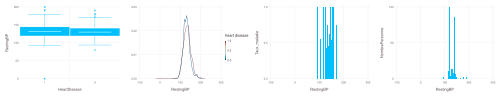

In [205]:
df = select(data_m, :RestingBP, :HeartDisease)
density_resting_bp = plot(data_m, x=:RestingBP, color=:HeartDisease, Geom.density, Guide.xlabel(string(:RestingBP)), Guide.colorkey(title="heart disease"))
bar_resting_bp_mean = plot(combine(groupby(data_m, :RestingBP), :HeartDisease => mean => :Taux_maladie), x=:RestingBP, y=:Taux_maladie, Geom.bar)
bar_resting_bp_distribution = plot(combine(groupby(data_m, :RestingBP), nrow => :NombrePersonne), x=:RestingBP, y=:NombrePersonne, Geom.bar)
df.HeartDisease = string.(df.HeartDisease)
boxplot_resting_bp = plot(df, x=:HeartDisease, y=:RestingBP, Geom.boxplot)
Gadfly.set_default_plot_size(50cm, 10cm)
hstack(boxplot_resting_bp,density_resting_bp, bar_resting_bp_mean, bar_resting_bp_distribution)



On peut remarquer que la prédiction de la maladie cardiaque n'est pas vraiment influencée par le RestingBP, puisque la distribution selon les deux classes est très similaire. Il ne sera donc pas pertinent d'utiliser cette variable pour l'entrainement du modèle et pour les prédictions.

#### 2.7 Maladie cardiaque en fonction du cholesterol

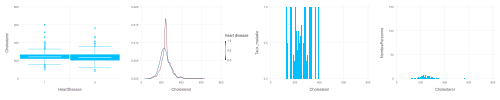

In [206]:
df = select(data_m, :Cholesterol, :HeartDisease)
density_chol = plot(data_m, x=:Cholesterol, color=:HeartDisease, Geom.density, Guide.xlabel(string(:Cholesterol)), Guide.colorkey(title="heart disease"))
bar_chol_mean = plot(combine(groupby(data_m, :Cholesterol), :HeartDisease => mean => :Taux_maladie), x=:Cholesterol, y=:Taux_maladie, Geom.bar)
bar_chol_distribution = plot(combine(groupby(data_m, :Cholesterol), nrow => :NombrePersonne), x=:Cholesterol, y=:NombrePersonne, Geom.bar)
df.HeartDisease = string.(df.HeartDisease)
boxplot = plot(df, x=:HeartDisease, y=:Cholesterol, Geom.boxplot)
Gadfly.set_default_plot_size(50cm, 10cm)
hstack(boxplot, density_chol, bar_chol_mean, bar_chol_distribution)


En remplaçant les valeurs manquantes du cholesterol par la moyenne des données observées de cet attribut, nous pouvons observer que celui-ci n'a pas une grande influence sur la prédiction de maladie cardiaque, puisque la distribution est très similaire pour les deux classes. Il ne sera donc pas pertinent d'utiliser cette variable pour notre modèle.

#### 2.8 Maladie cardiaque en fonction de la glycémie à jeun

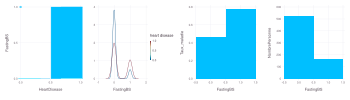

In [207]:
df = select(data_m, :FastingBS, :HeartDisease)

box_bs = plot(df, x=:HeartDisease, y=:FastingBS, Geom.boxplot)
density_bs = plot(df, x=:FastingBS, color=:HeartDisease, Geom.density, Guide.xlabel(string(:FastingBS)), Guide.colorkey(title="heart disease"))
bar_bs_mean = plot(combine(groupby(df, :FastingBS), :HeartDisease => mean => :Taux_maladie), x=:FastingBS, y=:Taux_maladie, Geom.bar)
bar_bs_distribution = plot(combine(groupby(df, :FastingBS), nrow => :NombrePersonne), x=:FastingBS, y=:NombrePersonne, Geom.bar)
Gadfly.set_default_plot_size(35cm, 10cm)
hstack(box_bs, density_bs, bar_bs_mean, bar_bs_distribution)

On peut alors remarquer que la glycémie à jeun semble avoir un pouvoir prédictif, comme l'indique la croissance de la probabilité de maladie cardiaque en fonction de la valeur de FastingBS (lorsqu'elle vaut 1).

#### 2.9 Maladie cardiaque en fonction de l'électrocardiogramme au repos

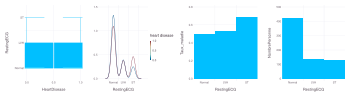

In [208]:
df = select(data_m, :RestingECG, :HeartDisease)

box_ecg = plot(df, x=:HeartDisease, y=:RestingECG, Geom.boxplot)
density_ecg = plot(df, x=:RestingECG, color=:HeartDisease, Geom.density, Guide.xlabel(string(:RestingECG)), Guide.colorkey(title="heart disease"))
bar_ecg_mean = plot(combine(groupby(df, :RestingECG), :HeartDisease => mean => :Taux_maladie), x=:RestingECG, y=:Taux_maladie, Geom.bar)
bar_ecg_distribution = plot(combine(groupby(df, :RestingECG), nrow => :NombrePersonne), x=:RestingECG, y=:NombrePersonne, Geom.bar)
Gadfly.set_default_plot_size(35cm, 10cm)
hstack(box_ecg, density_ecg, bar_ecg_mean, bar_ecg_distribution)

Pour l'électrocardiogramme au repos, il n'est pas évident de déterminer si cette variable possède un pouvoir significatif, puisque la probabilité moyenne de maladie cardiaque semble être toujours au dessus de 0.5, indiquant une prédiction de 1 en grande majorité peu importe la valeur de RestingECG. Cette variable pourra être testée, mais semble a priori être inutile.

#### 2.10 Maladie cardiaque en fonction du rythme cardiaque maximum

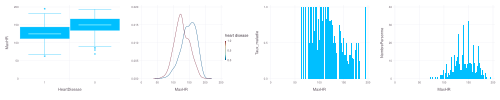

In [209]:
df = select(data_m, :MaxHR, :HeartDisease)
density_hr = plot(data_m, x=:MaxHR, color=:HeartDisease, Geom.density, Guide.xlabel(string(:MaxHR)), Guide.colorkey(title="heart disease"))
bar_hr_mean = plot(combine(groupby(data_m, :MaxHR), :HeartDisease => mean => :Taux_maladie), x=:MaxHR, y=:Taux_maladie, Geom.bar)
bar_hr_distribution = plot(combine(groupby(data_m, :MaxHR), nrow => :NombrePersonne), x=:MaxHR, y=:NombrePersonne, Geom.bar)
df.HeartDisease = string.(df.HeartDisease)
boxplotMaxHR = plot(df, x=:HeartDisease, y=:MaxHR, Geom.boxplot)
Gadfly.set_default_plot_size(50cm, 10cm)
hstack(boxplotMaxHR,density_hr, bar_hr_mean, bar_hr_distribution)


À nouveau, le rythme cardiaque maximum semble être une caractéristique significative, étant donné les deux distributions différentes selon la classe de prédiction et le fait que la prédiction moyenne de maladie cardiaque diminue lorsque le rythme augmente.

#### 2.11 Maladie cardiaque en fonction de l'angine causée par l'exercice

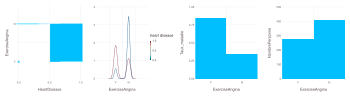

In [210]:
df = select(data_m, :ExerciseAngina, :HeartDisease) 

box_angina = plot(df, x=:HeartDisease, y=:ExerciseAngina, Geom.boxplot)
density_angina = plot(df, x=:ExerciseAngina, color=:HeartDisease, Geom.density, Guide.xlabel(string(:ExerciseAngina)), Guide.colorkey(title="heart disease"))
bar_angina_mean = plot(combine(groupby(df, :ExerciseAngina), :HeartDisease => mean => :Taux_maladie), x=:ExerciseAngina, y=:Taux_maladie, Geom.bar)
bar_angina_distribution = plot(combine(groupby(df, :ExerciseAngina), nrow => :NombrePersonne), x=:ExerciseAngina, y=:NombrePersonne, Geom.bar)
Gadfly.set_default_plot_size(35cm, 10cm)
hstack(box_angina, density_angina, bar_angina_mean, bar_angina_distribution)

 L'angine causée par l'exercice peut donc aussi posséder un pouvoir de prédiction significatif, puisque ses deux valeurs possibles distinguent bien les deux classes de prédictions.

#### 2.12 Maladie cardiaque en fonction de la mesure sur l'électrocardiogramme

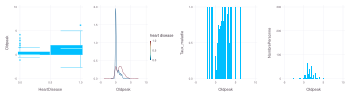

In [211]:
df = select(data_m, :Oldpeak, :HeartDisease)

box_old = plot(df, x=:HeartDisease, y=:Oldpeak, Geom.boxplot)
density_old = plot(df, x=:Oldpeak, color=:HeartDisease, Geom.density, Guide.xlabel(string(:Oldpeak)), Guide.colorkey(title="heart disease"))
bar_old_mean = plot(combine(groupby(df, :Oldpeak), :HeartDisease => mean => :Taux_maladie), x=:Oldpeak, y=:Taux_maladie, Geom.bar)
bar_old_distribution = plot(combine(groupby(df, :Oldpeak), nrow => :NombrePersonne), x=:Oldpeak, y=:NombrePersonne, Geom.bar)
Gadfly.set_default_plot_size(35cm, 10cm)
hstack(box_old, density_old, bar_old_mean, bar_old_distribution)

Les deux distributions sont à nouveau différentes, montrant que l'on peut estimer que cet attribut est utile pour la prédiction de la maladie cardiaque.

#### 2.13 Maladie cardiaque en fonction de la pente sur l'électrocardiogramme

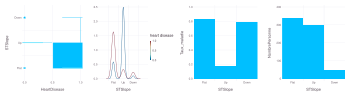

In [212]:
df = select(data_m, :STSlope, :HeartDisease)

box_slope = plot(df, x=:HeartDisease, y=:STSlope, Geom.boxplot)
density_slope = plot(df, x=:STSlope, color=:HeartDisease, Geom.density, Guide.xlabel(string(:STSlope)), Guide.colorkey(title="heart disease"))
bar_slope_mean = plot(combine(groupby(df, :STSlope), :HeartDisease => mean => :Taux_maladie), x=:STSlope, y=:Taux_maladie, Geom.bar)
bar_slope_distribution = plot(combine(groupby(df, :STSlope), nrow => :NombrePersonne), x=:STSlope, y=:NombrePersonne, Geom.bar)
Gadfly.set_default_plot_size(35cm, 10cm)
hstack(box_slope, density_slope, bar_slope_mean, bar_slope_distribution)

Cette variable semble bien distinguer les deux classes. Alors, on pourra aussi l'inclure lors de l'entrainement de notre modèle.

#### 2.14 Détection de multicolinéarité

Après l'analyse des données, nous pouvons indiquer que les variables les plus significatives semblent être : Age, Sex, ChestPainType, FastingBS, MaxHR, ExerciseAngina, Oldpeak, STSlope et peut-être RestingECG. Nous voudrions aussi déterminer s'il y a présence de multi-colinéarité parmi les attributs. Or, étant donné que la majorité de nos attributs sont catégoriques, il est impossible d'utiliser directement la PCA ou l'analyse du VIF, puisque ces méthodes sont basées sur des données continues. Toutefois, comme il est expliqué plus bas, nous avons essayé un modèle de prédiction basé sur la PCA, après avoir modifié nos données pour s'assurer que toutes les variables explicatives soient des nombres et que les colonnes ayant plusieurs catégories possibles soient converties en plusieurs colonnes présentant la présence (1) ou non (0) d'une catégorie spécifique (One-hot). La présence de multicolinéarité sera donc présenté ci-dessous.

In [213]:
plots = Plot[]

for x_propertyname in propertynames(data[!, Not([:ID, :HeartDisease])])
    for y_propertyname in propertynames(data[!, Not([:ID, :HeartDisease])])
        push!(
            plots,
            plot(
                data,
                x=x_propertyname,
                y=y_propertyname,
                color=data.HeartDisease,
                Guide.xlabel(nothing),
                Guide.xticks(label=false),
                Guide.ylabel(nothing),
                Guide.yticks(label=false),
                Theme(key_position=:none),
            )
        )
    end
end

Gadfly.set_default_plot_size(50cm, 50cm)
property_count = ncol(data[!, Not([:ID, :HeartDisease])])
grid_plot = gridstack(reshape(plots, (property_count, property_count)))

In [ ]:
# Convertir tous les colonnes catégorique en valeur numérique
weights = [1,1,1,1,1,1,1,1,1,1,1];                                       
df = df_to_float(data, weights);

# Sortir la matrice de corélation
Gadfly.set_default_plot_size(12cm, 12cm)
spy(cor(Matrix(df[!, Not([:HeartDisease])])))

Après avoir converti tous  les caractéristiques en valeur numérique. La matrice de corrélation a été générée avec ces valeurs et aucune présence de multicolinéarité n’a été détectée.

## 3. Séparation des données

Afin de pouvoir tester la performance de notre modèle de manière locale avant d'effectuer des submissions sur Kaggle, nous avons divisé notre ensemble de données en un ensemble d'entrainement et un ensemble de validation. Pour ce faire, nous avons choisis de transformer l'ordre des données de manière aléatoire, pour ensuite prendre 20% de celles-ci comme ensemble de validation.

In [ ]:
function train_valid_split(df)
    Random.seed!(2)
    df.Oldpeak = string.(df.Oldpeak)

    train_size = Int(floor(nrow(df)*0.8))
    sample_rows = sample(1:nrow(df), train_size, replace=false)
    df_train = df[sample_rows,:]
    test_rows = setdiff(1:nrow(df), sample_rows)
    df_test = df[test_rows,:]
    return df_train, df_test
end

#### 3.1 Transformation des données continues

De plus, nous avons pensé essayer de trouver des séparations possibles pour les attributs continus, afin de les rendre catégoriques et ainsi aider le modèle de régression à effectuer des prédictions.

In [ ]:
# Transformation pour l'Age
df = select(data, :Age, :MaxHR, :Oldpeak, :HeartDisease)
convert_age_3_class(df, (54,60))

# Transformation pour MaxHR
convert_MaxHR(df, 134)

# Transformation pour MaxHR
convert_oldpeak_2_class(df,0.8)

Gadfly.set_default_plot_size(35cm, 10cm)

df_Age = combine(groupby(df, :Age), :HeartDisease => mean => :Taux_maladie)
age_graph = plot(df_Age, x=:Age, y=:Taux_maladie, Geom.bar)
df_Max = combine(groupby(df, :MaxHR), :HeartDisease => mean => :Taux_maladie)
max_graph = plot(df_Max, x=:MaxHR, y=:Taux_maladie, Geom.bar)
df_Old = combine(groupby(df, :Oldpeak), :HeartDisease => mean => :Taux_maladie)
old_graph = plot(df_Old, x=:Oldpeak, y=:Taux_maladie, Geom.bar)

hstack(age_graph, max_graph, old_graph)

Nous allons tester plusieurs valeurs pour le seuil de séparation afin de trouver les valeurs qui permettent de mieux séparer les données continues selon les deux classes de prédiction. Nous allons donc pouvoir tester dans nos modèles si ces séparations peuvent améliorer nos résultats. De plus, les fonctions utilisées ci-dessus sont définies au début de ce Notebook.

## 4. Ajustement d'un modèle utilisant les arbres de décision

### 4.1 Exemple simple d'un modèle d'arbre
Nous avons essayer de construire un modèle basé sur les arbres de décision. L'utilisation d'une librairie pour l'entrainement des arbres a été utilisé pour voir rapidement si ce modèle pour faire être pertinent. 

Pour ce modèle, seulement les variables identifié comme les plus significative identifié à l'analyse de données on été utilisé. Ces variables sont:
- Age 
- Sex, 
- ChestPainType 
- FastingBS
- MaxHR
- ExerciseAngina
- Oldpeak
- STSlope 
- RestingECG



In [ ]:
# Create a split set
df = replace_missing_by_mean(data);
standardise_df(df);
train, test = train_valid_split(df);

# Features
features = [:Age, :Sex, :ChestPainType, :FastingBS, :MaxHR, :ExerciseAngina, :Oldpeak, :STSlope, :RestingECG];
target = [:HeartDisease];

# Convert training and test to Matrix and vector 
train_X = Matrix(train[!, features]);
train_y = vec(Array(train[!, target]));

test_X = Matrix(test[!, features]);
test_y = vec(Array(test[!, target]));

# With all the data
all_X = Matrix(df[!, features]);
all_y = vec(Array(df[!, target]));

In [ ]:
function test_decision_tree_model_accuracy(model, test_X, test_y)
    # Predict and check accuracy
    ŷ = DecisionTree.predict(model, test_X);
    good_pred = 0;
    for i=1:length(test_y)
        if test_y[i] == ŷ[i]
            good_pred += 1;
        end
    end
    accuracy = good_pred / length(test_y)

end

In [ ]:
# Basic Model
model = DecisionTree.DecisionTreeClassifier(max_depth=2); 
DecisionTree.fit!(model, train_X, train_y);

# Predict and check accuracy
ŷ = DecisionTree.predict(model, test_X);
good_pred = 0;
for i=1:length(test_y)
    if test_y[i] == ŷ[i]
         good_pred += 1;
    end
end
println(test_decision_tree_model_accuracy(model, test_X, test_y))

### 4.2 Analyse des résultats des arbres de décision

En créant un modèle de base d'arbre de décision, on obtient un résultat de bonne qualité. Mais après avoir fait une recherche des meilleurs paramètres possible par l'utilisation de validation croisée, la précision du modèle pour la séparation training et validation prédéfinie décente à 83%. Lors de la validation croisée, le meilleur modèle trouvé permet d'atteindre une précision moyenne de 86%, mais ce résultat varie beaucoup entre les six différentes séparations du jeu de validation croisé. Pour ces raisons, ce modèle a été abandonné pour un modèle permettant de donner de meilleurs résultats, et ce de façon constante. 

## 5. Ajustement d'un modèle utilisant la PCA
Nous avons essayé de faire un modèle basé sur la PCA. Ces modèle a été inspiré par les modèles de PCA présentés dans l'exemple de rapport de projet final A2020 de ce cours (https://moodle.polymtl.ca/mod/resource/view.php?id=489985). Cependant, après avoir testé ce modèle, nous avons réalisé qu'il ne donnait pas de meilleurs résultats que le meilleur modèle de régression logistique trouvé, expliqué plus bas. Ainsi, nous ne présentons ici que les fonctions utilisés dans la création du modèle de PCA et ses prédictions, sans l'appeller dans le calepin, puisque nous ne l'utilisons pas dans le modèle final.


#### 5.1 Méthodes utiles pour le modèle de PCA
La méthode convert_string_variables_to_one_hot() n'est pas utilisée ailleurs dans le calepin, car nous avons découvert que nous avions de meilleurs résultats sans les one-hot pour la régression logistique.

In [ ]:
function convert_string_variables_to_one_hot(df)
    """
    Function convertissant les colonnes contenant des string en plusieurs colonnes one-hot.
    Des colonnes pour chaque catégorie sont ajoutées et les valeurs possibles sont
    0 (catégorie non présente) ou 1 (catégorie présente).
    @params:
        - df: DataFrame à modifier
    """
    # Sex
    df.Sex_int = df.Sex .== "F" # F:1, M:0

    # ChestPainType
    df.ChestPainType_TA = df.ChestPainType .== "TA"
    df.ChestPainType_ATA = df.ChestPainType .== "ATA"
    df.ChestPainType_NAP = df.ChestPainType .== "NAP"
    df.ChestPainType_ASY = df.ChestPainType .== "ASY"

    # RestingECG
    df.RestingECG_Normal = df.RestingECG .== "Normal"
    df.RestingECG_ST = df.RestingECG .== "ST"
    df.RestingECG_LVH = df.RestingECG .== "LVH"

    # ExerciseAngina
    df.ExerciseAngina_int = df.ExerciseAngina .== "Y" # Y:1, N:0

    # ST_Slope
    df.ST_Slope_Up = df.STSlope .== "Up"
    df.ST_Slope_Flat = df.STSlope .== "Flat"
    df.ST_Slope_Down = df.STSlope .== "Down"
end


function filter_string_variables(df)
    """
    Function retournant un dataframe sans les colonnes contenant encore des strings.
    @params:
        - df: DataFrame à modifier
    """
    df_no_string = select(df, Not([:Sex, :ChestPainType, :STSlope, :ExerciseAngina, :RestingECG]))
    return df_no_string
end


function get_z_score_x(df)
    """
    Function retournant le Z Score selon X.
    @params:
        - df: DataFrame
    """
    z_score_x = StatsBase.fit(StatsBase.ZScoreTransform, convert(Matrix{Float64}, df[!, Not([:ID, :HeartDisease])]), dims=1)
    return z_score_x
end

function get_z_score_y(df)
    """
    Function retournant le Z Score selon Y.
    @params:
        - df: DataFrame
    """
    z_score_y = StatsBase.fit(StatsBase.ZScoreTransform, df.HeartDisease, dims=1)
    return z_score_y
end


#### 5.2 Modèle PCA simple
Il est à noter que ce modèle utilise toutes les composantes principales. Puisqu'il n'y a pas de multicolinéarité dans les données, nous pouvons nous permettre d'utiliser toutes les composantes principales sans problème. Dans ce modèle, les colonnes sont d'abord converties en one-hot et les colonnes contenant des string sont ignorées. Ensuite, les variables explicatives et la variable de résultat (y) sont standardisées pour créer la matrice Z et la matrice y respectivement. Nous effectuons ensuite la transformation SVD sur Z et nous calculons la matrice V, qui est ensuite utilisée pour trouver la matrice des composantes principales T. Les coefficients de régression linéaire n sont ensuite calculés et utilisés pour obtenir les coefficients beta. Le beta est ensuite retourné pour être utilisé dans la prédiction, présentée plus bas.

In [ ]:
function pca_model(df)
    """
    Function créant un modèle PCA simple avec toutes les composantes principales
    et retournant beta.
    @params:
        - df: DataFrame
    """
    df_one_hot = convert_string_variables_to_one_hot(df)
    df_clean = filter_string_variables(df_one_hot)
    z_score_x = get_z_score_x(df_clean)
    z_score_y = get_z_score_y(df_clean)
    
    # La matrice y
    y = StatsBase.transform(z_score_y, convert(Array{Float64}, df_clean.HeartDisease))
    # La matrice Z avec toutes les colonnes (sauf ID et HeartDisease, car ce ne sont pas des variables explicatives)
    Z = StatsBase.transform(z_score_x, convert(Matrix{Float64}, df_clean[!, Not([:ID, :HeartDisease])]),)

    F = svd(Z)
    V = F.V
    T = Z * V
    
    n = T \ y
    beta = V * n
    return beta
end


#### 5.3 Prédiction pour le modèle PCA

In [ ]:
function pca_predict(beta, z_score_x, z_score_y, df)
    """
    Function retournant theta pour la prédiction à partir du modèle de PAC simple
    @params:
        - beta: le beta trouvé avec la création du modèle de PCA simple
        - z_score_x: le Z Score selon X
        - z_score_y: le Z Score selon Y
        - df: DataFrame
    """
    df =  df[!, Not([:ID, :HeartDisease])]
    X = StatsBase.transform(z_score_x, convert(Matrix{Float64}, df))
    theta = StatsBase.reconstruct(z_score_y, X * beta)
    return theta
end

#### 5.4 Analyse du modèle PCA
Après avoir essayé le modèle de PCA simple, nous avons réalisé qu'il obtenait de moins bons résultats que le modèle de régression logistique (qui avait été essayé plus tôt et qui est expliqué ci-bas). Nous pouvons supposer que cela est dû au fait que bien que le modèle de PCA est bon, il semblait sur-apprendre à partir des données d'entrainement et de valdiation. En effet, nous avons obtenu des résultats de bonne prédiction à environ 90% sur l'ensemble de validation, mais seulement d'environ 83% sur l'ensemble de test. C'est pourquoi nous avons préféré utiliser le modèle de régression logistique, expliqué plus bas, qui semble moins sur-apprendre et offrir de meilleurs résultats de prédiction sur l'ensemble de test. Si nous avions eu plus de temps, nous aurions pu essayer divers modèles PCA utilisant les fonctions logit ou probit, ou encore en essayant la PCA avec différents nombres de composantes principales, au lieu de toutes les prendre. Limiter le nombre de composantes principales aurait peut-être pu permettre d'éviter le sur-apprentissage.

## 6. Ajustement d'un modèle de régression logistique
Nous avons d'abord pensé entrainer un modèle de régression logistique avec les attributs les plus importants.

#### 6.1 Préparation et transformation des données pour l'entrainement

Pour ce premier modèle, nous avons choisis de transformer uniquement l'attribut Oldpeak en classe catégorique. De plus, nous avons transformé les données de type "Down" pour STSlope en type "Flat", étant donné que les deux fournissent la même information pour la prédiction. Les autres variables les plus importantes sont laissées inchangées.

In [ ]:
# Préparation des données pour l'entrainement
df = select(data_m, Not(:ID))
i = 1
for v in df.Oldpeak
    if v <= 0.5
        df.Oldpeak[i] = Int(1)
    else
        df.Oldpeak[i] = Int(2)
    end
    i += 1
end
i = 1
for v in df.STSlope
    if v == "Down"
        df.STSlope[i] = "Flat"
    end
    i += 1
end
df.Oldpeak = string.(df.Oldpeak)
df

#### 6.2 Partitionnement du jeu de données en un ensemble d'entraînement et un ensemble de test

In [ ]:
# Séparation de l'ensemble d'entrainement en un ensemble de train et de test,
# afin de pouvoir valider la performance en local
df_train, df_test = train_valid_split(df)
df_test

#### 6.3 Le modèle pour la première tentative de régression logistique

Ce modèle de régression logistique est le premier modèle à plusieurs variables explicatives que nous avons tenté suite à l'analyse exploratoire des données effectuée à la partie 2. La combinaison de variables parmis celles ayant retenu notre attention etait donc: STSlope, ChestPainType, ExerciseAngina, Sex, Oldpeak.

 Nous avons donc réuni dans cette tentative de façon arbitraire les variables qui semblaient apporter de l'information. Le pourcentage de prédictions correctes (Accuracy) pour l'ensemble de test local de ce modèle s'élevait a 86.23 %. En effet, pour mesurer l'efficacite de chaque tentative, nous evaluons le pourcentage de predictions reussies sur l'ensemble de test en local.

In [ ]:
M = glm(@formula(HeartDisease ~ STSlope + ChestPainType + ExerciseAngina + Sex + Oldpeak), df_train, Bernoulli(), LogitLink())

#### 6.4 Evaluation sur l'ensemble de test local

In [ ]:
# Effectuer les predictions
θ̂ = GLM.predict(M, df_test)

ŷ = Int64[]

for θ̂ᵢ in θ̂
    if θ̂ᵢ >= .5
        push!(ŷ, 1)
    else
        push!(ŷ, 0)
    end
end

In [ ]:
# Calculer l'Accuracy
true_values = [i for i in df_test.HeartDisease]
acc = 0
i = 1
for pred in ŷ
    if pred == true_values[i]
        acc += 1
    end
    i += 1
end
acc = acc/nrow(df_test)

#### 6.5 Entrainement de la meilleure combinaison de données sur le modèle de régression logistique

Suite au modèle précèdent, notre objectif était de parvenir à obtenir une sélection de variables explicatives qui nous offrirait un meilleur résultat pour le modèle GLM sur le critère de pourcentage de prédictions valides. Le meilleur modèle étant donc celui qui assurerait le pourcentage de prédictions valides le plus élevé. Pour ce faire, nous avons effectué de multiples tentatives, avec chacune une combinaison de variables explicatives différente.

Le principe dans la sélection des variables explicatives est le même que pour celui du premier modèle de régression logistique de la section précédente. Par conséquent, suite à l’analyse exploratoire, nous avions connaissance des variables qui pourraient apporter de l’information. Toutefois, dans l’optique d’améliorer la solution obtenue, nous avons également tenté de récupérer de l’information depuis les variables moins susceptibles d’en contenir, et ce, en utilisant les fonctions de traitement de données de la section « Fonctions utiles pour le traitement de données » dont le but était de subdiviser les données en plusieurs plages. Or, en essayant avec plusieurs subdivisions possibles pour les variables continues les plus importantes, nous avons remarqué que c'était uniquement avec la variable Oldpeak que la division en valeurs catégoriques était bénéfique. Les autres variables continues ont donc été utilisées inchangées.

De cette manière, à partir des résultats obtenus en local pour chaque modèle, nous avons effectué la soumission sur Kaggle des modèles les plus performants. On retrouve ci-dessous le modèle qui nous a apporte notre meilleur score Kaggle actuel de 0.85217:



In [ ]:
M = glm(@formula(HeartDisease ~ Age + Sex + ChestPainType + ExerciseAngina + Oldpeak + FastingBS + STSlope), df_train, Bernoulli(), LogitLink())

In [ ]:
# Effectuer les predictions sur l'ensemble de validation
θ̂ = GLM.predict(M, df_test)

ŷ = Int64[]

for θ̂ᵢ in θ̂
    if θ̂ᵢ >= .5
        push!(ŷ, 1)
    else
        push!(ŷ, 0)
    end
end

In [ ]:
# Calculer l'Accuracy sur l'ensemble de validation
true_values = [i for i in df_test.HeartDisease]
acc = 0
i = 1
for pred in ŷ
    if pred == true_values[i]
        acc += 1
    end
    i += 1
end
acc = acc/nrow(df_test)

## 7. Prédiction des surverses pour les jours de l'ensemble de test

On utilise le meilleur modèle de la section précédente pour estimer la probabilité que le patient souffre d'une maladie cardiovasculaire.

#### 7.1 Chargement des données de l'ensemble de test

In [ ]:
test = CSV.read("test.csv", DataFrame);
test

In [ ]:
i = 1
for v in test.Oldpeak
    if v <= 0.5
        test.Oldpeak[i] = Int(1)
    else
        test.Oldpeak[i] = Int(2)
    end
    i += 1
end
i = 1
for v in test.STSlope
    if v == "Down"
        test.STSlope[i] = "Flat"
    end
    i += 1
end
test.Oldpeak = string.(test.Oldpeak)
test

#### 7.2 Entrainement du meilleur modèle sur toutes les données

In [ ]:
Random.seed!(0)
df.Oldpeak = string.(df.Oldpeak)

train_size = Int(floor(nrow(df)*0.85))
sample_rows = sample(1:nrow(df), train_size, replace=false)
df_train = df[sample_rows,:]
test_rows = setdiff(1:nrow(df), sample_rows)
df_test = df[test_rows,:]
M = glm(@formula(HeartDisease ~ Age + Sex + ChestPainType + ExerciseAngina + Oldpeak + FastingBS + STSlope), df_train, Bernoulli(), LogitLink())

In [ ]:
# Effectuer les predictions sur l'ensemble d'entrainement pour vérifier que tout est bon
θ̂ = GLM.predict(M, df)

ŷ = Int64[]

for θ̂ᵢ in θ̂
    if θ̂ᵢ >= .5
        push!(ŷ, 1)
    else
        push!(ŷ, 0)
    end
end

In [ ]:
# Calculer l'Accuracy sur l'ensemble d'entrainement pour vérifier que tout est bon
true_values = [i for i in df.HeartDisease]
acc = 0
i = 1
for pred in ŷ
    if pred == true_values[i]
        acc += 1
    end
    i += 1
end
acc = acc/nrow(df)

#### 7.3 Prédiction pour chacun des patients de l'ensemble de test

On prédit que le patient souffre d'une maladie cardiovasculaire si la probabilité est supérieure à 50%.

In [ ]:
θ̂ = GLM.predict(M, test)

ŷ = Int64[]

for θ̂ᵢ in θ̂
    if θ̂ᵢ >= .5
        push!(ŷ, 1)
    else
        push!(ŷ, 0)
    end
end


#### 7.4 Préparation du fichier des préditions pour téléverser sur Kaggle
Le fichier benchmark_predictions.csv généré peut être téléversé sur Kaggle. Il est composé d'une colonne d'identifiants (ID) et d'une colonne des diagnostics prédits.

In [ ]:
prediction = DataFrame(ID = test.ID, Prediction = ŷ)

CSV.write("benchmark_predictions_last.csv", prediction)

## 8 Discussion

Lors de ce projet, nous avons essayé plusieurs modèles, soit plusieurs modèles de régression logistique, un modèle d'arbre de décision et un modèle simple de PCA.

* Le modèle de PCA utilise toutes les composantes principales, mais donnait des résultats plus faibles que le meilleur modèle. Nous pensons que cela est dû à du sur-apprentissage, comme il a été expliqé plus haut. Nous aurions pu essayer divers modèles PCA utilisant les fonctions logit ou probit, ou encore en essayant la PCA avec différents nombres de composantes principales, au lieu de toutes les prendre. Limiter le nombre de composantes principales aurait peut-être également pu permettre d'éviter le sur-apprentissage.

* Le modèle d'arbre de décision testé utilise seulement les variables qui nous ont été identifiées comme les plus importantes. Un modèle de base a alors été généré et celui-ci donnait un résultat nous démontrant que le modèle était un possible candidat. Après une recherche des paramètres par validation croisés, le meilleur arbre trouvé permettait de donner une précision d'en moyenne de 86% sur toutes les partitions. Malheureusement, la précision variait beaucoup entre les partitions. Après avoir testé les meilleurs paramètres trouvés sur la partition permettant de comparer les modèles, le modèle performait moins bien que la meilleure régression. C'est pour cela que le modèle a été abandonné. Il aurait été intéressant de tester le modèle d'arbre sur plusieurs autres combinaisons de  variable et aussi essayer de laisser l'arbre classé classer les variables sans que celle-ci soit standardisée.

* Les modèles de régression logistique utilisaient uniquement les variables considérées comme les plus importantes. En transformant l'attribut Oldpeak en attribut catégorique et en utilisant une combinaison de Age, Sex, ChestPainType,ExerciseAngina, Oldpeak, FastingBS et STSlope, on obtient notre meilleur résultat sur l'ensemble de test Kaggle, soit 0.85217. 


Pour améliorer notre modèle, nous aurions pu essayer de trouver plus de séparations possibles pour les attributs continus afin de les diviser en plus que 2 ou 3 catégories et voir si cela aide pour les prédictions. Nous aurions aussi pu transformer les données continues en les standardisant ou normalisant pour les modèles de régression afin de les mettre sur la même échelle. Les modèles de régression ne semblaient pas sur-apprendre, puisqu'aucun coefficient n'est trop grand par rapport aux autres et que la performance du modèle sur l'ensemble total des données d'entrainement n'est pas proche de 100%. Nous avons aussi essayé quelques combinaisons d'attribut afin d'en créer de nouveaux ayant un plus grand pouvoir prédictif, mais sans succès. Nous aurions alors pu effectuer plus de recherches dans cette direction en analysant de manière plus précise les relations entre les attributs et peut-être trouver des combinaisons d'attributs qui semblaient inutiles à première vue mais qui peuvent être utiles lorsque mis ensemble. De plus, nous aurions pu essayer d'optimiser le seuil de décision de nos modèles, puisque nous avons maintenu un seuil de base de 0.5. Il serait alors possible qu'un seuil plus élevé ou plus petit améliore quelque peu la performance de notre meilleur modèle. 
 
